In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import numpy as np
from scipy import stats
import xarray as xr
import xcdat as xc
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm as BM
import pandas as pd
import matplotlib as mpl
import matplotlib.ticker as mticker
import netCDF4
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

In [3]:
mpl.rcParams['font.family'] = 'Arial'
mpl.rcParams['font.size'] = 12
# Edit axes parameters
mpl.rcParams['axes.linewidth'] = 2.0
# Tick properties
mpl.rcParams['xtick.major.size'] = 5
mpl.rcParams['xtick.minor.size'] = 3
mpl.rcParams['xtick.major.width'] = 1
mpl.rcParams['xtick.direction'] = 'out'
mpl.rcParams['ytick.major.size'] = 5
mpl.rcParams['ytick.minor.size'] = 3
mpl.rcParams['ytick.major.width'] = 1
mpl.rcParams['ytick.direction'] = 'out'

## importing data

In [4]:
pop_2020 = xc.open_dataset('./data/population/gpw_gridded_population_2020.nc', lon_orient=(-180, 180)).Band1

2024-03-08 20:19:32,135 [WARNING]: dataset.py(open_dataset:109) >> "No time coordinates were found in this dataset to decode. If time coordinates were expected to exist, make sure they are detectable by setting the CF 'axis' or 'standard_name' attribute (e.g., ds['time'].attrs['axis'] = 'T' or ds['time'].attrs['standard_name'] = 'time'). Afterwards, try decoding again with `xcdat.decode_time`."


In [5]:
aod = xc.open_mfdataset('./data/aerosol/MERRA_regrid/*.nc', lon_orient=(-180, 180)).AODANA.load()
aod

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 0:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 476 in H5O__attr_open_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #006: H5Adense.c line 394 in H5A__dense_open(): can't locate attribute in name index
    major: Attribute
    minor: Object not 

<xarray.DataArray 'AODANA' (time: 525, lat: 180, lon: 360)>
array([[[0.01715712, 0.01715638, 0.01715565, ..., 0.0171588 ,
         0.01715831, 0.01715771],
        [0.0174303 , 0.01741537, 0.01739964, ..., 0.0174512 ,
         0.01744571, 0.01743786],
        [0.01773494, 0.01777861, 0.01781606, ..., 0.01759667,
         0.01764492, 0.01769371],
        ...,
        [0.09874094, 0.09882691, 0.09890798, ..., 0.09850807,
         0.09858335, 0.09866597],
        [0.10150889, 0.10152163, 0.10153272, ..., 0.10146054,
         0.10147619, 0.10149322],
        [0.10528231, 0.10527537, 0.10526983, ..., 0.10530715,
         0.10529808, 0.1052893 ]],

       [[0.01727378, 0.01727013, 0.0172667 , ..., 0.01728375,
         0.01728052, 0.01727698],
        [0.01771773, 0.01770364, 0.0176897 , ..., 0.01774745,
         0.01774052, 0.01772886],
        [0.01888794, 0.01892865, 0.01896237, ..., 0.01875155,
         0.01880077, 0.01884848],
...
        [0.11065636, 0.11119337, 0.1117007 , ..., 0.10920829,
         0.1096696 , 0.11018765],
        [0.1137013 , 0.11404597, 0.11437137, ..., 0.11281694,
         0.11309664, 0.11341556],
        [0.11140594, 0.11147953, 0.11154662, ..., 0.11119325,
         0.11126408, 0.11133963]],

       [[0.02953696, 0.02956104, 0.02958321, ..., 0.02946863,
         0.02949118, 0.02951546],
        [0.02990632, 0.02993307, 0.02995081, ..., 0.02973953,
         0.02980546, 0.02986001],
        [0.03037336, 0.03058624, 0.03077658, ..., 0.02973296,
         0.02995466, 0.03017878],
        ...,
        [0.12194099, 0.12182146, 0.12171118, ..., 0.12227371,
         0.1221681 , 0.12204763],
        [0.12175801, 0.12173304, 0.12170345, ..., 0.12173785,
         0.12175123, 0.12175544],
        [0.1184903 , 0.11853454, 0.11857464, ..., 0.11836085,
         0.11840426, 0.11845022]]], dtype=float32)
Coordinates:
  * time     (time) object 1980-01-01 00:00:00 ... 2023-09-01 00:00:00
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
Attributes:
    long_name:       Aerosol Optical Depth Analysis
    units:           1
    fmissing_value:  1000000000000000.0
    vmax:            1000000000000000.0
    vmin:            -1000000000000000.0

In [6]:
aod_early = aod.sel(time = slice('1980', '1985')).mean('time')
aod_late = aod.sel(time = slice('2015', '2019')).mean('time')
aod_change = aod_late - aod_early

In [7]:
hdi_2015 = xc.open_dataset('./data/GDP_HDI/HDI_1990_2015_v2_regrid.nc', lon_orient=(-180, 180)).sel(time = 2015).HDI

2024-03-08 20:19:40,673 [WARNING]: dataset.py(_is_decodable:595) >> The 'units' attribute (year) for 'time' is not in the supported format 'X since Y', so it could not be decoded.


In [8]:
best100 = xr.open_dataset('./data/results/accl/best100.nc')
best70 = xr.open_dataset('./data/results/accl/best70.nc')
best50 = xr.open_dataset('./data/results/accl/best50.nc')
best30 = xr.open_dataset('./data/results/accl/best30.nc')

best5deg100 = xr.open_dataset('./data/results/accl/best5deg_100.nc')
best5deg70 = xr.open_dataset('./data/results/accl/best5deg_70.nc')
best5deg50 = xr.open_dataset('./data/results/accl/best5deg_50.nc')
best5deg30 = xr.open_dataset('./data/results/accl/best5deg_30.nc')

hadcrut5deg100 = xr.open_dataset('./data/results/accl/hadcrut5deg_100.nc')
hadcrut5deg70 = xr.open_dataset('./data/results/accl/hadcrut5deg_70.nc')
hadcrut5deg50 = xr.open_dataset('./data/results/accl/hadcrut5deg_50.nc')
hadcrut5deg30 = xr.open_dataset('./data/results/accl/hadcrut5deg_30.nc')

noaa5deg100 = xr.open_dataset('./data/results/accl/noaa5deg_100.nc')
noaa5deg70 = xr.open_dataset('./data/results/accl/noaa5deg_70.nc')
noaa5deg50 = xr.open_dataset('./data/results/accl/noaa5deg_50.nc')
noaa5deg30 = xr.open_dataset('./data/results/accl/noaa5deg_30.nc')

gistemp100 = xr.open_dataset('./data/results/accl/gistemp_100.nc')
gistemp70 = xr.open_dataset('./data/results/accl/gistemp_70.nc')
gistemp50 = xr.open_dataset('./data/results/accl/gistemp_50.nc')
gistemp30 = xr.open_dataset('./data/results/accl/gistemp_30.nc')

### masking over land using population data

In [9]:
best100['lat'] = pop_2020.lat
best100['lon'] = pop_2020.lon
best100_land = best100.where(~pop_2020.isnull())

best70['lat'] = pop_2020.lat
best70['lon'] = pop_2020.lon
best70_land = best70.where(~pop_2020.isnull())

best50['lat'] = pop_2020.lat
best50['lon'] = pop_2020.lon
best50_land = best50.where(~pop_2020.isnull())

best30['lat'] = pop_2020.lat
best30['lon'] = pop_2020.lon
best30_land = best30.where(~pop_2020.isnull())

aod_change['lat'] = pop_2020.lat
aod_change['lon'] = pop_2020.lon
aodc_land = aod_change.where(~pop_2020.isnull())

aod_change['lat'] = pop_2020.lat
aod_change['lon'] = pop_2020.lon
aodc_land = aod_change.where(~pop_2020.isnull())

hdi_2015['lat'] = pop_2020.lat
hdi_2015['lon'] = pop_2020.lon
hdi_land = hdi_2015.where(~pop_2020.isnull())

## some main plots

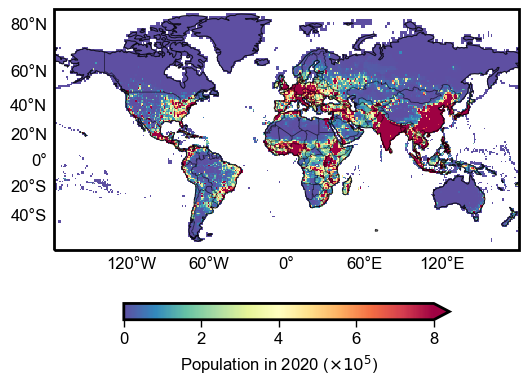

In [12]:
plt.figure(figsize=(6,7))
ax = plt.axes(projection=ccrs.Miller())
ax.set_extent([-180, 180, -60, 85])
lvls = np.arange(0, 8.1, 0.1)
(pop_2020/10**5).plot(cmap='Spectral_r', vmin=0, vmax=8, extend='max', transform=ccrs.PlateCarree(), cbar_kwargs=dict(orientation='horizontal', shrink=0.7, pad=0.10, label = r'Population in 2020 ($\times 10^{5}$)'))
# (pop_2020/10**5).plot.contourf(cmap='Spectral_r', levels=lvls, extend='max', transform=ccrs.PlateCarree(), \
                            #    cbar_kwargs=dict(orientation='horizontal', shrink=0.7, pad=0.10, label = r'Population in 2020 ($\times 10^{5}$)', ticks=np.arange(0, 10, 2)))
# (pop_2020/10**5).plot.contour(cmap='Spectral_r', levels=lvls, extend='max', transform=ccrs.PlateCarree())
# (np.log10(pop_2020)).plot(cmap='Spectral_r', vmin=0, vmax=7, extend='max', transform=ccrs.PlateCarree(), cbar_kwargs=dict(orientation='horizontal', shrink=0.7, pad=0.10, label = r'Population change [2020 - 2000] ($\times 10^{5}$)'))
ax.add_feature(cfeature.COASTLINE, lw=0.8, alpha=0.8, zorder=2)
# ax.add_feature(cfeature.OCEAN, color='white', zorde1=2)
ax.add_feature(cfeature.BORDERS, lw=0.6, alpha=0.6, zorder=2)
gl = ax.gridlines(draw_labels=True, alpha=0.)
gl.top_labels = False
gl.right_labels = False
ax.set_title('')
plt.savefig('./images/pop_2020.png', dpi=300, bbox_inches='tight')

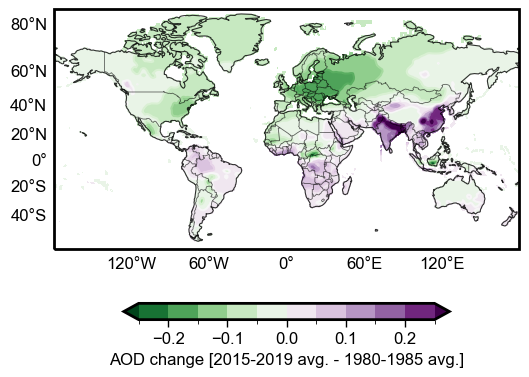

In [15]:
plt.figure(figsize=(6,7))
ax = plt.axes(projection=ccrs.Miller())
ax.set_extent([-180, 180, -60, 85])
lvls = np.arange(-0.25, 0.30, 0.05)
(aodc_land).plot.contourf(cmap='PRGn_r', levels=lvls, extend='both', transform=ccrs.PlateCarree(), \
                  cbar_kwargs=dict(orientation='horizontal', shrink=0.7, pad=0.10, label = 'AOD change [2015-2019 avg. - 1980-1985 avg.]', ticks=[-0.2, -0.1, 0, 0.1, 0.2]))
(aodc_land).plot.contour(cmap='PRGn_r', levels=lvls, extend='both', transform=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE, lw=0.8, alpha=0.8, zorder=2)
# ax.add_feature(cfeature.OCEAN, color='white', zorde1=2)
ax.add_feature(cfeature.BORDERS, lw=0.6, alpha=0.6, zorder=2)
gl = ax.gridlines(draw_labels=True, alpha=0.)
gl.top_labels = False
gl.right_labels = False
ax.set_title('')
plt.savefig('./images/aodc_land.png', dpi=300, bbox_inches='tight')

In [17]:
# set cutoff value of hdi
hdi_cutoff = 0.8

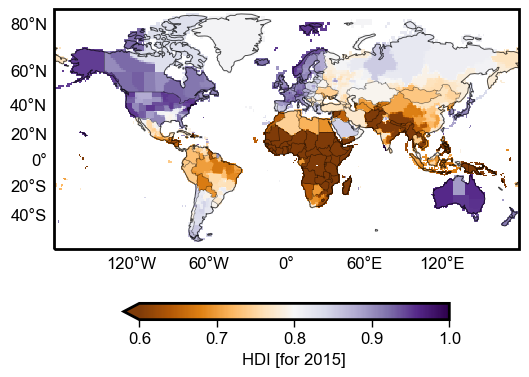

In [88]:
plt.figure(figsize=(6,7))
ax = plt.axes(projection=ccrs.Miller())
ax.set_extent([-180, 180, -60, 85])
(hdi_land).plot(cmap='PuOr', center=hdi_cutoff, vmax=1.0, extend='min', transform=ccrs.PlateCarree(), cbar_kwargs=dict(orientation='horizontal', shrink=0.7, pad=0.10, label = 'HDI [for 2015]'))
ax.coastlines(lw=0.7, alpha=0.7)
# ax.add_feature(cfeature.OCEAN, color='white', zorder=1)
ax.add_feature(cfeature.BORDERS, lw=0.5, alpha=0.5)
gl = ax.gridlines(draw_labels=True, alpha=0.)
gl.top_labels = False
gl.right_labels = False
ax.set_title('')
plt.savefig('./images/hdi.png', dpi=300, bbox_inches='tight')

## main analysis using BEST1deg (and different windows)

In [19]:
from functions import multivar_anal

In [77]:
df_low, df_high = multivar_anal.get_demarcated_data(pop_dat=pop_2020, accl_dat=best100_land.acccl, aodc_dat=aodc_land, hdi_dat=hdi_land, hdi_cutoff=hdi_cutoff, pop_cutoff=1000)

In [43]:
# def aodc_classification(row):
#     if row['aodc'] < 0:
#         val = 'dec.'
#     elif row['aodc'] >= 0 and row['aodc'] < 0.05:
#         val = 'low inc.'
#     elif row['aodc'] >= 0.05 and row['aodc'] < 0.1:
#         val = 'med. inc.'
#     elif row['aodc'] >= 0.1 and row['aodc'] < 0.15:
#         val = 'high inc.'
#     elif row['aodc'] >= 0.15:
#         val = 'extremely high inc.'
#     else:
#         val = np.nan
#     return val

# def popc_classification(row):
#     if row['popc'] < 4:
#         val = 'very low'
#     elif row['popc'] >= 4 and row['aodc'] < 5:
#         val = 'low'
#     elif row['popc'] >= 5 and row['aodc'] < 6:
#         val = 'high'
#     elif row['popc'] >= 6 and row['aodc'] < 7:
#         val = 'very high'
#     elif row['popc'] >= 7:
#         val = 'extremely high'
#     else:
#         val = np.nan
#     return val

In [44]:
# df_low['aodc_class'] = df_low.apply(aodc_classification, axis=1)
# df_low['popc_class'] = df_low.apply(popc_classification, axis=1)

# df_high['aodc_class'] = df_high.apply(aodc_classification, axis=1)
# df_high['popc_class'] = df_high.apply(popc_classification, axis=1)

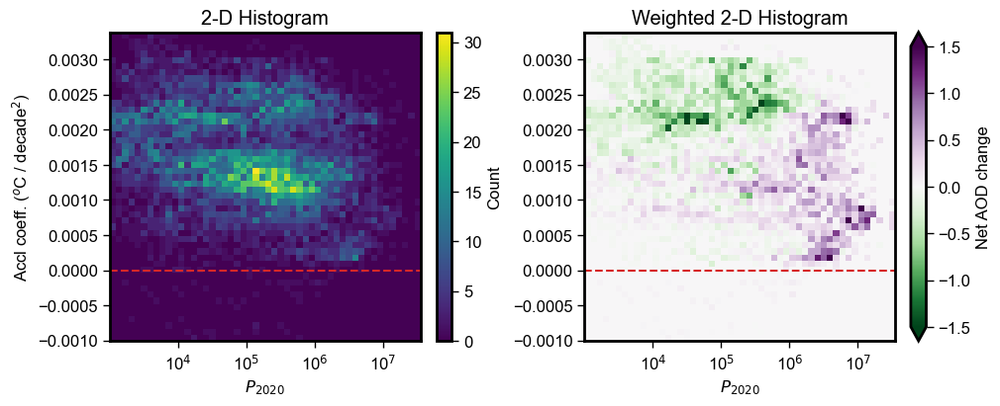

In [45]:
x = df_low.dropna()['pop']
y = df_low.dropna()['accl']
z = df_low.dropna()['aodc']

# xlab = r'$\log_{10}P_{2020} (P_{2020} > 1000)$'
xlab = r'$P_{2020}$'
ylab = 'Accl coeff. ($^{o}$C / decade$^{2}$)'
zlab = 'AOD change'

bins = 50
fig, axs = plt.subplots(1, 2, figsize=(10, 4), constrained_layout=True)
c, xe, ye, img = axs[0].hist2d(x, y, bins=bins)
fig.colorbar(img, ax=axs[0], label='Count')
axs[0].axhline(0.0, color='tab:red', ls='--')
axs[0].set(xlabel=xlab, ylabel=ylab, title='2-D Histogram')
axs[0].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

s, _, _, img = axs[1].hist2d(x, y, bins=bins, weights=z, cmap='PRGn_r', vmin=-1.5, vmax=1.5)
fig.colorbar(img, ax=axs[1], extend='both', label='Net ' + zlab)
axs[1].axhline(0.0, color='tab:red', ls='--')
axs[1].set(xlabel=xlab, ylabel='', title='Weighted 2-D Histogram')
axs[1].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

# # sums, _, _ = np.histogram2d(y, x, bins=bins, weights=z)
# means, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='mean')
# stds, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='std')
# # counts, xbins, ybins = np.histogram2d(y, x, bins=bins)
# counts, xbins, ybins, bn = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='count')
# # with np.errstate(divide='ignore', invalid='ignore'):  # suppress possible divide-by-zero warnings
# # img = axs[2].pcolormesh(ybins, xbins, (means * (counts/counts.std())), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# img = axs[2].pcolormesh(ybins, xbins, (means), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# # mask_means = np.ma.masked_greater_equal(counts, 5)
# # axs[2].pcolor(ybins, xbins, mask_means, alpha=0., hatch='///')
# # axs[2].pcolor(ybins, xbins, mask_means, alpha=1., color='k', cmap='binary')
# fig.colorbar(img, ax=axs[2], extend='both', label='Mean ' + zlab)
# axs[2].axhline(0.0, color='tab:red', ls='--')
# axs[2].set(xlabel=xlab, ylabel='', title='normalized hist.')
# axs[2].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

plt.savefig('./images/impact_plots/impact_low_hdi_30.png', dpi=300, bbox_inches='tight')

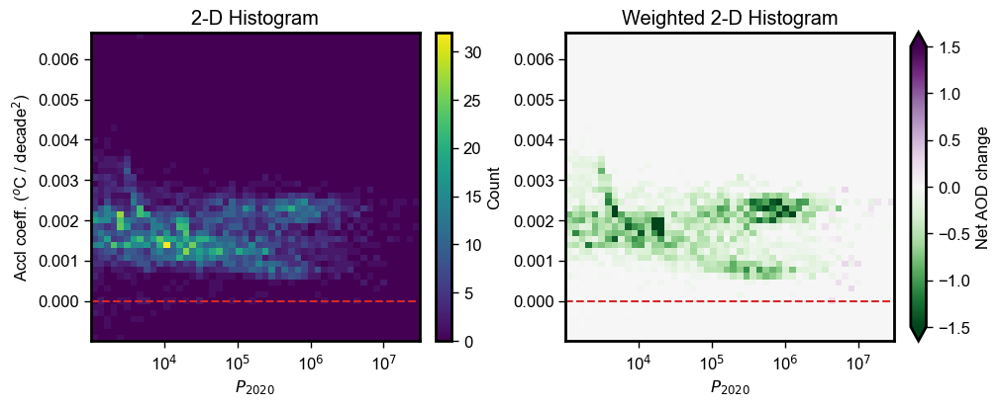

In [46]:
x = df_high.dropna()['pop']
y = df_high.dropna()['accl']
z = df_high.dropna()['aodc']

# xlab = r'$\log_{10}P_{2020} (P_{2020} > 1000)$'
xlab = r'$P_{2020}$'
ylab = 'Accl coeff. ($^{o}$C / decade$^{2}$)'
zlab = 'AOD change'

bins = 50
fig, axs = plt.subplots(1, 2, figsize=(10, 4), constrained_layout=True)
c, xe, ye, img = axs[0].hist2d(x, y, bins=bins)
fig.colorbar(img, ax=axs[0], label='Count')
axs[0].axhline(0.0, color='tab:red', ls='--')
axs[0].set(xlabel=xlab, ylabel=ylab, title='2-D Histogram')
axs[0].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

s, _, _, img = axs[1].hist2d(x, y, bins=bins, weights=z, cmap='PRGn_r', vmin=-1.5, vmax=1.5)
fig.colorbar(img, ax=axs[1], extend='both', label='Net ' + zlab)
axs[1].axhline(0.0, color='tab:red', ls='--')
axs[1].set(xlabel=xlab, ylabel='', title='Weighted 2-D Histogram')
axs[1].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

# # sums, _, _ = np.histogram2d(y, x, bins=bins, weights=z)
# means, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='mean')
# stds, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='std')
# # counts, xbins, ybins = np.histogram2d(y, x, bins=bins)
# counts, xbins, ybins, bn = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='count')
# # with np.errstate(divide='ignore', invalid='ignore'):  # suppress possible divide-by-zero warnings
# # img = axs[2].pcolormesh(ybins, xbins, (means * (counts/counts.std())), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# img = axs[2].pcolormesh(ybins, xbins, (means), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# # mask_means = np.ma.masked_greater_equal(counts, 5)
# # axs[2].pcolor(ybins, xbins, mask_means, alpha=0., hatch='///')
# # axs[2].pcolor(ybins, xbins, mask_means, alpha=1., color='k', cmap='binary')
# fig.colorbar(img, ax=axs[2], extend='both', label='Mean ' + zlab)
# axs[2].axhline(0.0, color='tab:red', ls='--')
# axs[2].set(xlabel=xlab, ylabel='', title='normalized hist.')
# axs[2].set_xticklabels(['', '10$^{4}$', '10$^{5}$', '10$^{6}$', '10$^{7}$'])

plt.savefig('./images/impact_plots/impact_high_hdi_30.png', dpi=300, bbox_inches='tight')

In [17]:
import seaborn as sns

#### using Hadcrut5 data and resampled pop and aod

In [60]:
pop_2020_5deg = xc.open_dataset('./data/population/gpw_gridded_population_2020_regrid_5d.nc', lon_orient=(-180, 180)).Band1

2024-03-08 20:42:52,220 [WARNING]: dataset.py(open_dataset:109) >> "No time coordinates were found in this dataset to decode. If time coordinates were expected to exist, make sure they are detectable by setting the CF 'axis' or 'standard_name' attribute (e.g., ds['time'].attrs['axis'] = 'T' or ds['time'].attrs['standard_name'] = 'time'). Afterwards, try decoding again with `xcdat.decode_time`."


In [48]:
aod_5deg = xc.open_mfdataset('./data/aerosol/MERRA_regrid_5d/*.nc', lon_orient=(-180, 180)).AODANA

In [49]:
aod_early_5deg = aod_5deg.sel(time = slice('1980', '1985')).mean('time')
aod_late_5deg = aod_5deg.sel(time = slice('2015', '2019')).mean('time')
aodc_5deg = aod_late_5deg - aod_early_5deg

In [50]:
hdi_2015_5deg = xc.open_dataset('./data/GDP_HDI/HDI_1990_2015_v2_regrid_5d.nc', lon_orient=(-180, 180)).HDI.sel(time = 2015)

2024-03-08 20:41:56,072 [WARNING]: dataset.py(_is_decodable:595) >> The 'units' attribute (year) for 'time' is not in the supported format 'X since Y', so it could not be decoded.


In [51]:
# masking

hadcrut5deg100 = hadcrut5deg100.rename(dict(latitude='lat', longitude='lon'))
hadcrut5deg100['lat'] = pop_2020_5deg.lat
hadcrut5deg100['lon'] = pop_2020_5deg.lon
hadcrut5deg100_land = hadcrut5deg100.where(~pop_2020_5deg.isnull())

hdi_2015_5deg['lat'] = pop_2020_5deg.lat
hdi_2015_5deg['lon'] = pop_2020_5deg.lon
hdi5deg_land = hdi_2015_5deg.where(~pop_2020_5deg.isnull())

aodc_5deg['lat'] = pop_2020_5deg.lat
aodc_5deg['lon'] = pop_2020_5deg.lon
aodc5deg_land = aodc_5deg.where(~pop_2020_5deg.isnull())

In [52]:
hadcrut5deg70 = hadcrut5deg70.rename(dict(latitude='lat', longitude='lon'))
hadcrut5deg70['lat'] = pop_2020_5deg.lat
hadcrut5deg70['lon'] = pop_2020_5deg.lon
hadcrut5deg70_land = hadcrut5deg70.where(~pop_2020_5deg.isnull())

hadcrut5deg50 = hadcrut5deg50.rename(dict(latitude='lat', longitude='lon'))
hadcrut5deg50['lat'] = pop_2020_5deg.lat
hadcrut5deg50['lon'] = pop_2020_5deg.lon
hadcrut5deg50_land = hadcrut5deg50.where(~pop_2020_5deg.isnull())

hadcrut5deg30 = hadcrut5deg30.rename(dict(latitude='lat', longitude='lon'))
hadcrut5deg30['lat'] = pop_2020_5deg.lat
hadcrut5deg30['lon'] = pop_2020_5deg.lon
hadcrut5deg30_land = hadcrut5deg30.where(~pop_2020_5deg.isnull())

In [53]:
# hadcrut5deg100 = hadcrut5deg100.rename(dict(latitude='lat', longitude='lon'))
noaa5deg100['lat'] = pop_2020_5deg.lat
noaa5deg100['lon'] = pop_2020_5deg.lon
noaa5deg100_land = noaa5deg100.where(~pop_2020_5deg.isnull())

noaa5deg30['lat'] = pop_2020_5deg.lat
noaa5deg30['lon'] = pop_2020_5deg.lon
noaa5deg30_land = noaa5deg30.where(~pop_2020_5deg.isnull())

# gistemp100['lat'] = pop_2020_2deg.lat
# gistemp100['lon'] = pop_2020_2deg.lon
# gistemp100_land = gistemp100.where(~pop_2020_2deg.isnull())

In [61]:
df_low, df_high = multivar_anal.get_demarcated_data(pop_dat=pop_2020_5deg, accl_dat=hadcrut5deg100_land.acccl, aodc_dat=aodc5deg_land, hdi_dat=hdi5deg_land, hdi_cutoff=hdi_cutoff, pop_cutoff=1000)

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 0:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 476 in H5O__attr_open_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #006: H5Adense.c line 394 in H5A__dense_open(): can't locate attribute in name index
    major: Attribute
    minor: Object not 

In [62]:
df_low.dropna()

,pop,accl,aodc
817,5.309402,0.000255,0.000958
831,5.630491,0.001824,0.006351
832,4.706704,0.001355,0.004638
833,5.562910,0.001870,0.005695
834,5.739237,0.001671,0.025813
...,...,...,...
2150,3.005682,0.001098,-0.027485
2202,4.972651,-0.000056,-0.134182
2203,4.193092,0.000173,-0.133703
2274,4.424698,-0.000450,-0.102656


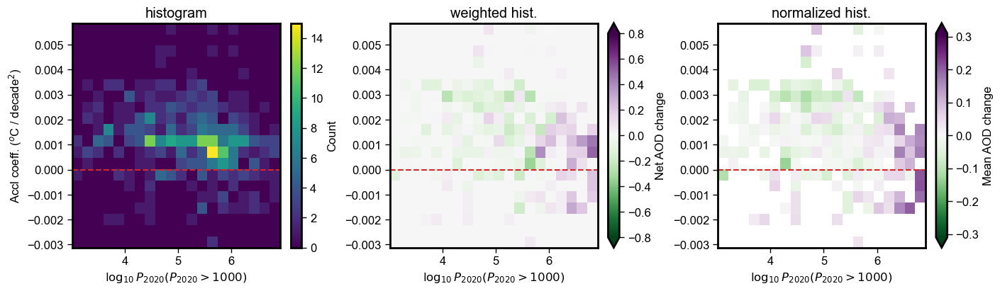

In [65]:
x = df_low.dropna()['pop']
y = df_low.dropna()['accl']
z = df_low.dropna()['aodc']

xlab = r'$\log_{10}P_{2020} (P_{2020} > 1000)$'
ylab = 'Accl coeff. ($^{o}$C / decade$^{2}$)'
zlab = 'AOD change'

bins = 20
fig, axs = plt.subplots(1, 3, figsize=(14, 4), constrained_layout=True)
c, xe, ye, img = axs[0].hist2d(x, y, bins=bins)
fig.colorbar(img, ax=axs[0], label='Count')
axs[0].axhline(0.0, color='tab:red', ls='--')
axs[0].set(xlabel=xlab, ylabel=ylab, title='histogram')

s, _, _, img = axs[1].hist2d(x, y, bins=bins, weights=z, cmap='PRGn_r', vmin=-0.8, vmax=0.8)
fig.colorbar(img, ax=axs[1], extend='both', label='Net ' + zlab)
axs[1].axhline(0.0, color='tab:red', ls='--')
axs[1].set(xlabel=xlab, ylabel='', title='weighted hist.')

# sums, _, _ = np.histogram2d(y, x, bins=bins, weights=z)
means, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='mean')
stds, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='std')
# counts, xbins, ybins = np.histogram2d(y, x, bins=bins)
counts, xbins, ybins, bn = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='count')
# with np.errstate(divide='ignore', invalid='ignore'):  # suppress possible divide-by-zero warnings
# img = axs[2].pcolormesh(ybins, xbins, (means * (counts/counts.std())), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
img = axs[2].pcolormesh(ybins, xbins, (means), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# mask_means = np.ma.masked_greater_equal(counts, 5)
# axs[2].pcolor(ybins, xbins, mask_means, alpha=0., hatch='///')
# axs[2].pcolor(ybins, xbins, mask_means, alpha=1., color='k', cmap='binary')
fig.colorbar(img, ax=axs[2], extend='both', label='Mean ' + zlab)
axs[2].axhline(0.0, color='tab:red', ls='--')
axs[2].set(xlabel=xlab, ylabel='', title='normalized hist.')

plt.savefig('./images/impact_plots/impact_low_hdi_100_hadcrut.png', dpi=300, bbox_inches='tight')

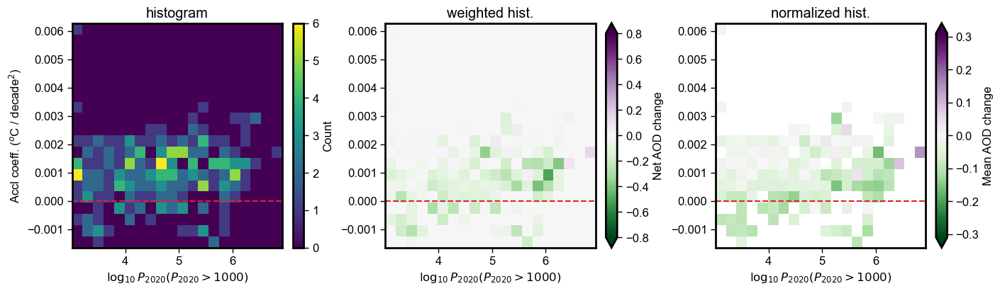

In [66]:
x = df_high.dropna()['pop']
y = df_high.dropna()['accl']
z = df_high.dropna()['aodc']

xlab = r'$\log_{10}P_{2020} (P_{2020} > 1000)$'
ylab = 'Accl coeff. ($^{o}$C / decade$^{2}$)'
zlab = 'AOD change'

bins = 20
fig, axs = plt.subplots(1, 3, figsize=(14, 4), constrained_layout=True)
c, xe, ye, img = axs[0].hist2d(x, y, bins=bins)
fig.colorbar(img, ax=axs[0], label='Count')
axs[0].axhline(0.0, color='tab:red', ls='--')
axs[0].set(xlabel=xlab, ylabel=ylab, title='histogram')

s, _, _, img = axs[1].hist2d(x, y, bins=bins, weights=z, cmap='PRGn_r', vmin=-0.8, vmax=0.8)
fig.colorbar(img, ax=axs[1], extend='both', label='Net ' + zlab)
axs[1].axhline(0.0, color='tab:red', ls='--')
axs[1].set(xlabel=xlab, ylabel='', title='weighted hist.')

# sums, _, _ = np.histogram2d(y, x, bins=bins, weights=z)
means, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='mean')
stds, _, _, _ = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='std')
# counts, xbins, ybins = np.histogram2d(y, x, bins=bins)
counts, xbins, ybins, bn = stats.binned_statistic_2d(y, x, bins=bins, values=z, statistic='count')
# with np.errstate(divide='ignore', invalid='ignore'):  # suppress possible divide-by-zero warnings
# img = axs[2].pcolormesh(ybins, xbins, (means * (counts/counts.std())), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
img = axs[2].pcolormesh(ybins, xbins, (means), cmap='PRGn_r', vmin=-0.31, vmax=0.31)
# mask_means = np.ma.masked_greater_equal(counts, 5)
# axs[2].pcolor(ybins, xbins, mask_means, alpha=0., hatch='///')
# axs[2].pcolor(ybins, xbins, mask_means, alpha=1., color='k', cmap='binary')
fig.colorbar(img, ax=axs[2], extend='both', label='Mean ' + zlab)
axs[2].axhline(0.0, color='tab:red', ls='--')
axs[2].set(xlabel=xlab, ylabel='', title='normalized hist.')

plt.savefig('./images/impact_plots/impact_high_hdi_100_hadcrut.png', dpi=300, bbox_inches='tight')

### Drawing out some statistics using BEST 100yr

In [78]:
# props
meanpointprops_low = dict(marker='^', markeredgecolor='tab:orange',
                      markerfacecolor='white', markersize=5)
meanpointprops_high = dict(marker='^', markeredgecolor='tab:purple',
                      markerfacecolor='white', markersize=5)

boxprops_low = dict(linestyle='-', linewidth=2, color='tab:orange')
boxprops_high = dict(linestyle='-', linewidth=2, color='tab:purple')

flierprops_low = dict(marker='o', markerfacecolor='tab:orange', markersize=5,
                  markeredgecolor='tab:orange')
flierprops_high = dict(marker='o', markerfacecolor='tab:purple', markersize=5,
                  markeredgecolor='tab:purple')

medianprops_low = dict(linestyle='-', linewidth=2, color='tab:orange', alpha=0.7)
medianprops_high = dict(linestyle='-', linewidth=2, color='tab:purple', alpha=0.7)

whiskerprops_low = dict(color='tab:orange')
whiskerprops_high = dict(color='tab:purple')
capprops_low = dict(color='tab:orange')
capprops_high = dict(color='tab:purple')

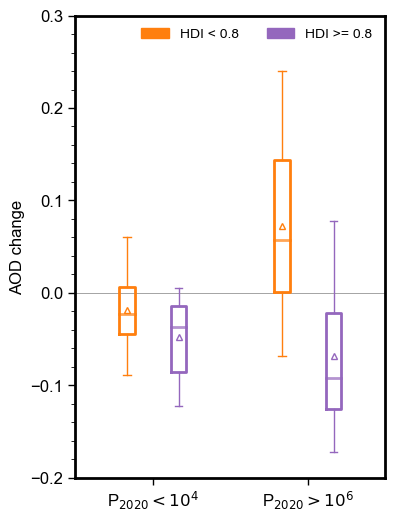

In [86]:
plt.figure(figsize=(4,6))

plt.axhline(0.0, color='k', lw=0.5, ls='-', alpha=0.5)
plt.boxplot([df_low[df_low['pop'] < 4.0]['aodc'],  df_low[df_low['pop'] > 6.0]['aodc']], positions=[1, 4], whis=[5,95], showfliers=False, widths=0.3, showmeans=True, \
            meanprops=meanpointprops_low, boxprops=boxprops_low, flierprops=flierprops_low, medianprops=medianprops_low, whiskerprops=whiskerprops_low, capprops=capprops_low)
plt.boxplot([df_high[df_high['pop'] < 4.0]['aodc'], df_high[df_high['pop'] > 6.0]['aodc']], positions=[2, 5], whis=[5,95], showfliers=False, widths=0.3, showmeans=True, \
            meanprops=meanpointprops_high, boxprops=boxprops_high, flierprops=flierprops_high, medianprops=medianprops_high, whiskerprops=whiskerprops_high, capprops=capprops_high)


plt.fill_between([-2, -2.1], [-2, -2.1], color='tab:orange', label=f'HDI < {hdi_cutoff}')
plt.fill_between([-2, -2.1], [-2, -2.1], color='tab:purple', label=f'HDI >= {hdi_cutoff}')
plt.xlim(0, 6)
plt.ylim(-0.2, 0.3)
plt.xticks([1.5, 4.5])
plt.gca().set_xticklabels(['P$_{2020} < 10^{4}$', 'P$_{2020} > 10^{6}$'])
plt.minorticks_on()
plt.gca().tick_params(which='minor', axis='x', bottom=False)
plt.ylabel('AOD change')
# sns.despine()

plt.legend(frameon=False, fontsize=10, ncols=2)
plt.savefig('./images/impact_plots/box_aodc.png', dpi=300, bbox_inches='tight')

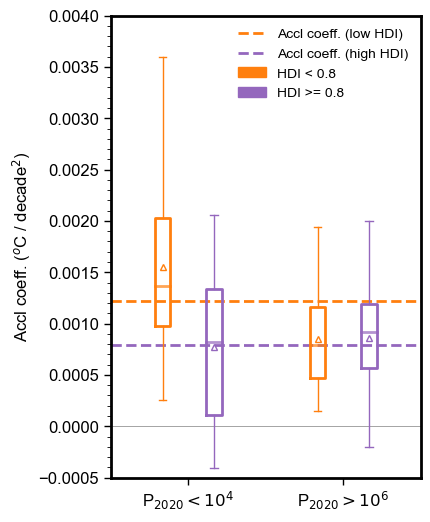

In [87]:
plt.figure(figsize=(4,6))

plt.axhline(accl_lh, ls='--', lw=2.0, color='tab:orange', label = 'Accl coeff. (low HDI)')
plt.axhline(accl_hh, ls='--', lw=2.0, color='tab:purple', label = 'Accl coeff. (high HDI)')
plt.axhline(0.0, color='k', lw=0.5, ls='-', alpha=0.5)
plt.boxplot([df_low[df_low['pop'] < 4.0]['accl'],  df_low[df_low['pop'] > 6.0]['accl']], positions=[1, 4], whis=[5,95], showfliers=False, widths=0.3, showmeans=True, \
            meanprops=meanpointprops_low, boxprops=boxprops_low, flierprops=flierprops_low, medianprops=medianprops_low, whiskerprops=whiskerprops_low, capprops=capprops_low)
plt.boxplot([df_high[df_high['pop'] < 4.0]['accl'], df_high[df_high['pop'] > 6.0]['accl']], positions=[2, 5], whis=[5,95], showfliers=False, widths=0.3, showmeans=True, \
            meanprops=meanpointprops_high, boxprops=boxprops_high, flierprops=flierprops_high, medianprops=medianprops_high, whiskerprops=whiskerprops_high, capprops=capprops_high)
plt.ylim(-0.0005, 0.004)

plt.fill_between([-2, -2.1], [-2, -2.1], color='tab:orange', label=f'HDI < {hdi_cutoff}')
plt.fill_between([-2, -2.1], [-2, -2.1], color='tab:purple', label=f'HDI >= {hdi_cutoff}')
plt.xlim(0, 6)
plt.xticks([1.5, 4.5])
plt.gca().set_xticklabels(['P$_{2020} < 10^{4}$', 'P$_{2020} > 10^{6}$'])
plt.minorticks_on()
plt.gca().tick_params(which='minor', axis='x', bottom=False)
plt.ylabel('Accl coeff. ($^{o}$C / decade$^{2}$)')
# sns.despine()

plt.legend(frameon=False, fontsize=10, ncols=1)
plt.savefig('./images/impact_plots/box_accl.png', dpi=300, bbox_inches='tight')


In [80]:
accl_lplh, accl_hplh  = df_low[df_low['pop'] < 4.0]['accl'].mean(),  df_low[df_low['pop'] > 6.0]['accl'].mean()
accl_lplh, accl_hplh

(0.0015515945148195172, 0.0008498495565882223)

In [81]:
accl_lphh, accl_hphh  = df_high[df_high['pop'] < 4.0]['accl'].mean(),  df_high[df_high['pop'] > 6.0]['accl'].mean()
accl_lphh, accl_hphh

(0.0007698236633730228, 0.0008618944270170538)

In [82]:
accl_lh = df_low['accl'].mean()
accl_hh = df_high['accl'].mean()
accl_hh, accl_lh

(0.0007905011907294004, 0.0012158992918832106)

In [83]:
((accl_lh - accl_hh)/accl_hh)*100

53.81372047792779

In [84]:
((accl_lplh - accl_lphh)/accl_hh)*100

98.89559441715066

In [85]:
((accl_hplh - accl_hphh)/accl_hh)*100

-1.523700478897138